In [1]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pylab as plt
import math

Here we load the first image.

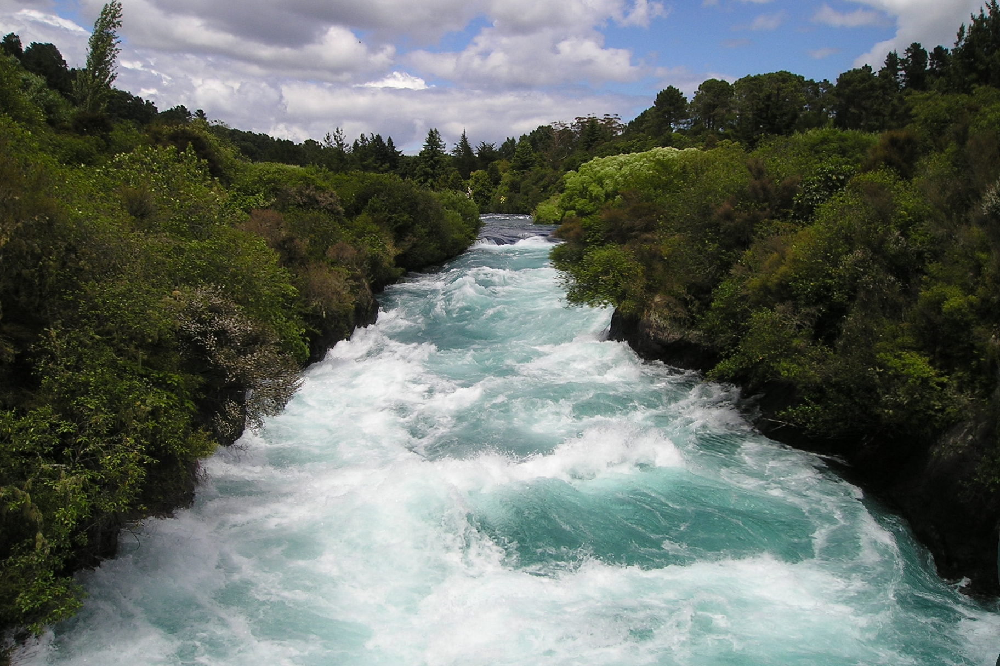

In [3]:
img_left = cv2.imread('./res01.jpg')
img_left = cv2.resize(img_left, (int(img_left.shape[1]/3), int(img_left.shape[0]/3)))
cv2_imshow(img_left)

And now we load the second image.

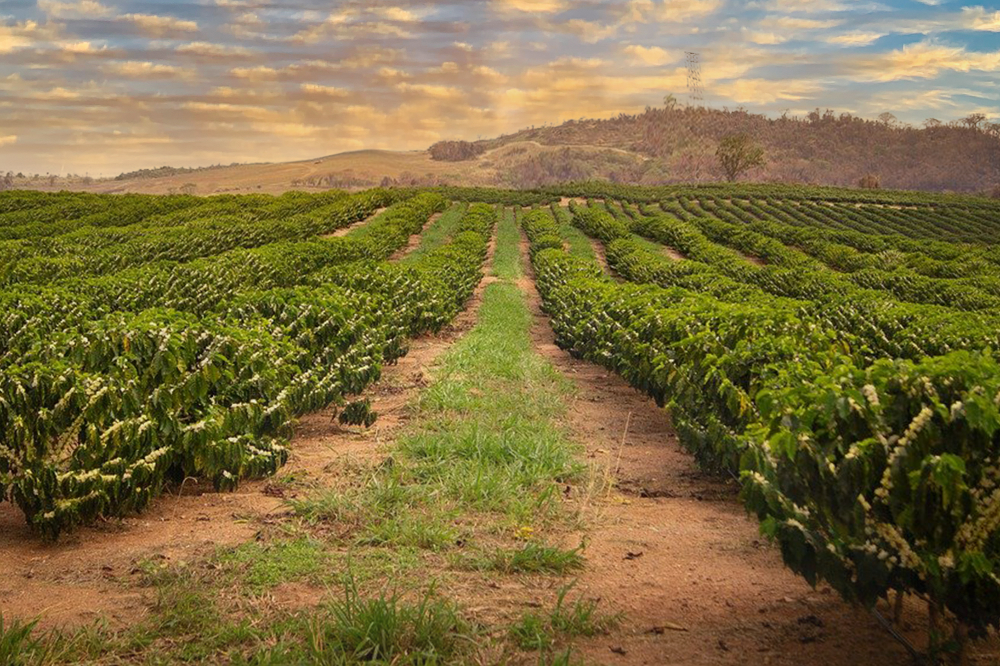

In [4]:
img_right = cv2.imread('./image-3.jpg')
img_right = cv2.resize(img_right, (int(img_right.shape[1]/3), int(img_right.shape[0]/3)))
cv2_imshow(img_right)

Here we create our binary mask. In this case it's vertical line from center of the width of the images with a little offset towards the left part (5 px).  

In [5]:
masked = np.ones_like(img_right[:, :, 0], dtype=np.float32)
masked[:, int(img_right.shape[1]/2) - 5 :] = 0

This function receives an offset and make a smooth gradient from $ center - offset $ to $ center + offset $. We use this in different steps of our algorithm.

In [6]:
def create_mask(mask, offset):
  new_mask = mask.copy()
  gradient = np.linspace(1, 0, 2 * offset)
  center = int(mask.shape[1]/2) - 5
  new_mask[:, center - offset: center + offset] = gradient
  return new_mask

In [7]:
kernel_sizes = [1, 7, 23, 37, 73, 199]
mask_offset_sizes = [15, 40, 100, 200, 400, 800]

In [8]:
mask_stack = [create_mask(masked, offset) for offset in mask_offset_sizes]

In [9]:
gaussian_stack_left = [cv2.blur(img_left, (k, k), borderType=cv2.BORDER_REFLECT) for k in kernel_sizes]
gaussian_stack_right = [cv2.blur(img_right, (k, k), borderType=cv2.BORDER_REFLECT) for k in kernel_sizes]

In [10]:
laplacian_stack_left = [np.subtract(gaussian_stack_left[i-1], gaussian_stack_left[i], dtype=np.float32) for i in range(1, 6)]
laplacian_stack_right = [np.subtract(gaussian_stack_right[i-1], gaussian_stack_right[i], dtype=np.float32) for i in range(1, 6)]

In [11]:
laplacian_stack_left.append(gaussian_stack_left[-1])
laplacian_stack_right.append(gaussian_stack_right[-1])

In [12]:
def blend(alpha, left, right):
  alpha = cv2.cvtColor(alpha, cv2.COLOR_GRAY2BGR)
  return alpha * left + (1- alpha) * right

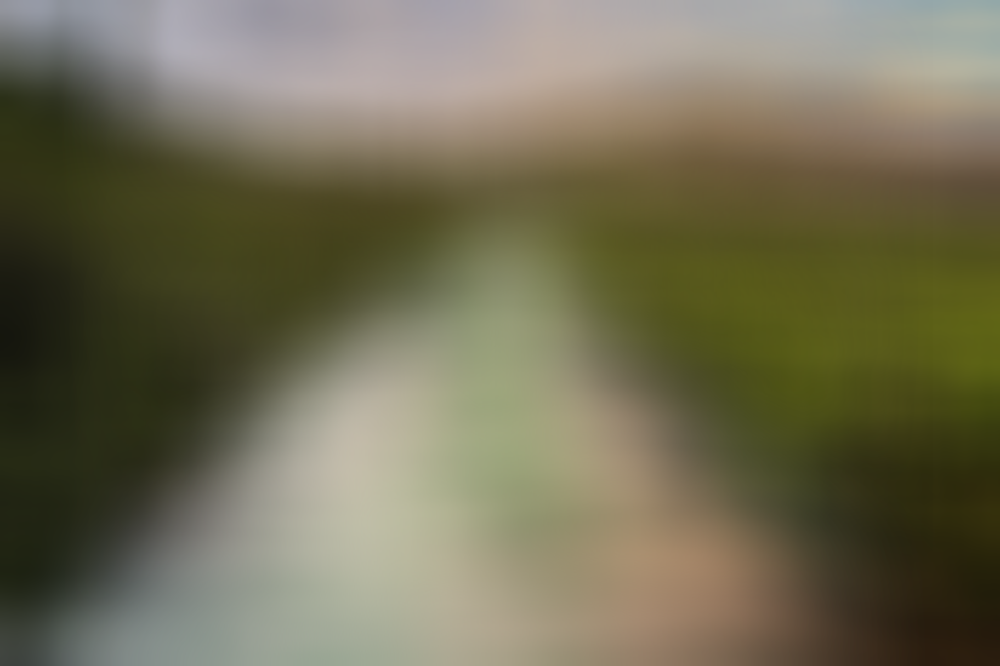

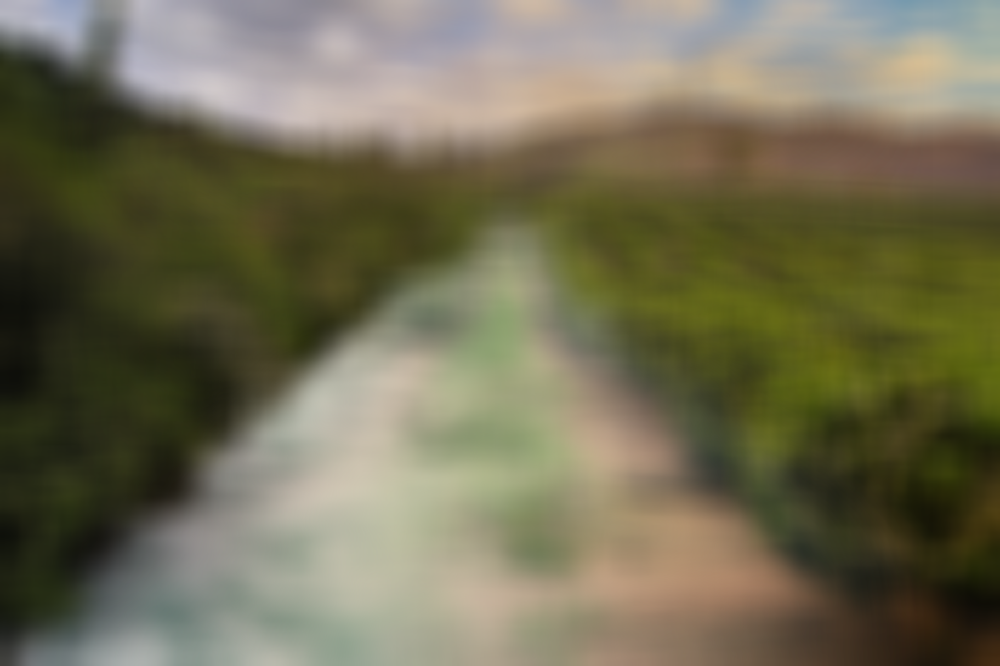

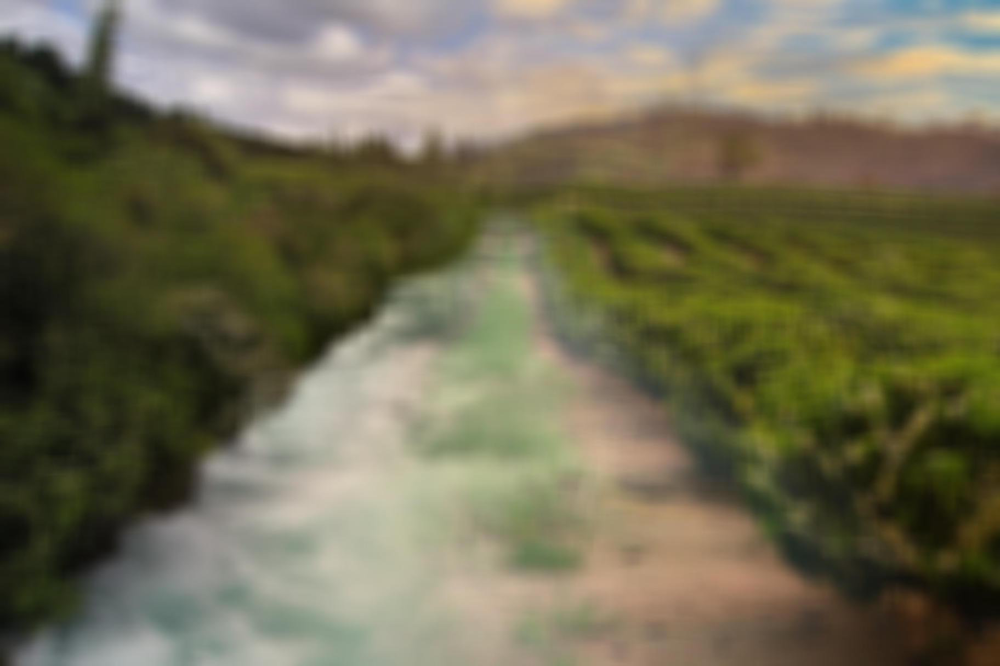

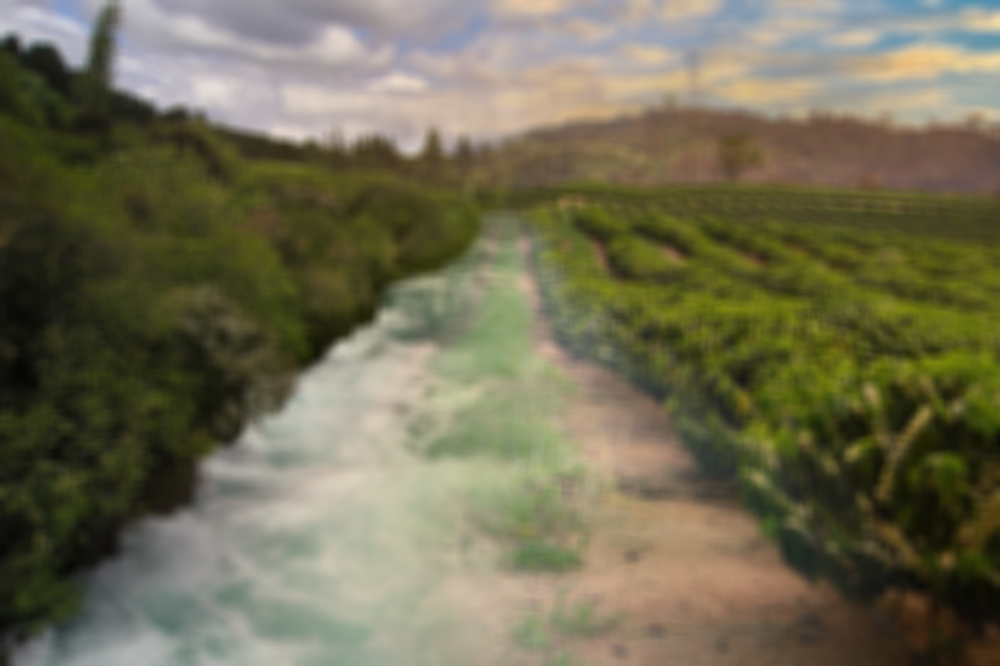

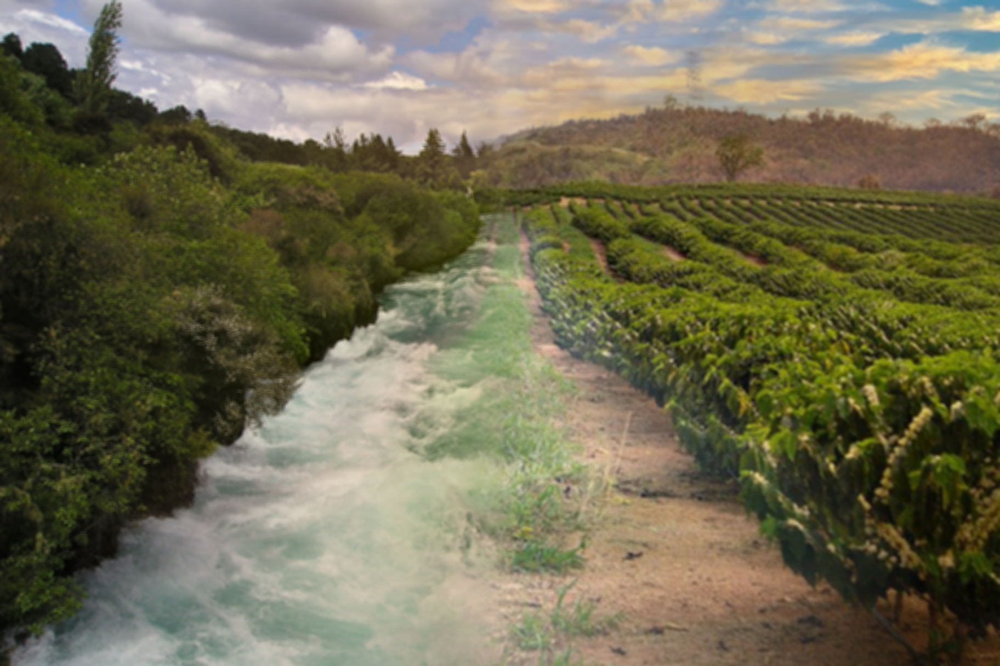

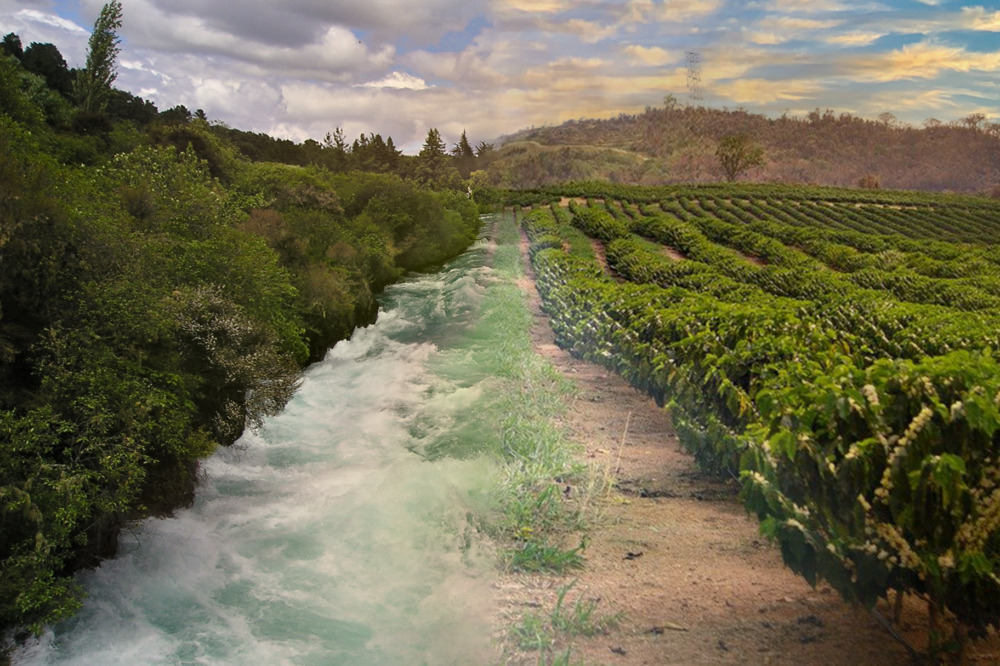

In [13]:
reconstruct_img = np.zeros_like(img_left, dtype=np.float32)
for i in range(1, len(laplacian_stack_left)+1):
  reconstruct_img += blend(mask_stack[-i], laplacian_stack_left[-i], laplacian_stack_right[-i])
  # cv2_imshow(cv2.hconcat([laplacian_stack_left[-i], laplacian_stack_right[-i]]))
  cv2_imshow(reconstruct_img)